<a href="https://colab.research.google.com/github/leiparov/pucp_deeplearning/blob/master/TimberTransfer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **TimberTransfer con CycleGAN**
En este notebook mostraremos la aplicación de una arquitectura llamada CycleGAN para convertir timbres de teclado electrónico a timbres de guitarra acústica. Como se mostró en la aplicación base del proyecto, CycleGAN permitía transformar caballos a zebras y bajo el mismo concepto, intentaremos hacer dicha transformación pero con los espectogramas de los sonidos del teclado y la guitarra.




## Librerías y configuraciones iniciales

In [ ]:
#importamos las liberarías necesarias:
import tensorflow as tf
import tensorflow_datasets as tfds
import os
import time
import matplotlib.pyplot as plt
from IPython.display import clear_output
import numpy as np

import PIL
import PIL.Image
import pathlib

# declaramos AUTOTUNE:
AUTOTUNE = tf.data.experimental.AUTOTUNE

%tensorflow_version 2.x

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

## Cargamos las imágenes para el modelo

In [ ]:
# Directorios donde se encuentran las imagenes para el entrenamiento
PATH = "/content/drive/My Drive/Proyecto Deep Learning - Grupo F/Data/"
KEYBOARD_PATH = PATH + "keyboard_electronic/"
GUITAR_PATH = PATH + "guitar_acoustic/"

# Método para cargar las imágenes de cada dataset y generar los subdataset train y test.
def train_set_from_files (data, train_split = 0.8): #data: list de archivos 
  image_count = len(list(data))
  train_index = round(image_count * train_split)
  data_random = np.copy(data)
  np.random.seed(23)
  np.random.shuffle(data_random)
  train = data_random[:train_index]
  test = data_random[train_index:]
  return train, test

# Preparamos el dataset para las imágenes de los espectogramas del Teclado electrónico.
keyboard_files = !ls "{KEYBOARD_PATH}" -1
borrar = [
"'MIDI-Unprocessed_01_R1_2008_01-04_ORIG_MID--AUDIO_01_R1_2008_wav--2_030 (1).png'",
"'MIDI-Unprocessed_01_R1_2008_01-04_ORIG_MID--AUDIO_01_R1_2008_wav--2_031 (1).png'",
"'MIDI-Unprocessed_01_R1_2008_01-04_ORIG_MID--AUDIO_01_R1_2008_wav--2_032 (1).png'",
"'MIDI-Unprocessed_01_R1_2008_01-04_ORIG_MID--AUDIO_01_R1_2008_wav--2_033 (1).png'",
"'MIDI-Unprocessed_01_R1_2008_01-04_ORIG_MID--AUDIO_01_R1_2008_wav--2_034 (1).png'"
]
[keyboard_files.remove(x) for x in borrar]

keyboard_train, keyboard_test = train_set_from_files(keyboard_files)
print("KEYBOARD DataSet: {}".format(len(keyboard_files)))
print("KEYBOARD Train DataSet: {}".format(len(keyboard_train)))
print("KEYBOARD Test DataSet: {}".format(len(keyboard_test)))

# Preparamos el dataset para las imágenes de los espectogramas de la Guitarra acústica.
guitar_files = !ls "{GUITAR_PATH}" -1
borrar = [
"'MIDI-Unprocessed_01_R1_2008_01-04_ORIG_MID--AUDIO_01_R1_2008_wav--3_117 (1).png'",
"'MIDI-Unprocessed_01_R1_2008_01-04_ORIG_MID--AUDIO_01_R1_2008_wav--3_119 (1).png'"
]
[guitar_files.remove(x) for x in borrar]


guitar_train, guitar_test = train_set_from_files(guitar_files)
print("GUITAR DataSet: {}".format(len(guitar_files)))
print("GUITAR Train DataSet: {}".format(len(guitar_train)))
print("GUITAR Test DataSet: {}".format(len(guitar_test)))


[None, None, None, None, None]

KEYBOARD DataSet: 1821
KEYBOARD Train DataSet: 1457
KEYBOARD Test DataSet: 364


[None, None]

GUITAR DataSet: 1821
GUITAR Train DataSet: 1457
GUITAR Test DataSet: 364


## Métodos para preprocesamiento de imágenes

In [ ]:
#d Dimensiones de la imagen
IMG_WIDTH = 256
IMG_HEIGHT = 256

# Reescalar imagen
def resize (inputimg, height, width):
  inputimg = tf.image.resize(inputimg, [height, width])
  return inputimg

# Normalizar imagen
def normalize (inputimg):
  inputimg = (inputimg / 127.5) - 1  
  return inputimg

# Transformación de imagen
@tf.function()
def random_jitter(inputimg):
  inputimg = resize(inputimg, 286, 286)

  stacked_image = tf.stack([inputimg], axis = 0)
  cropped_image = tf.image.random_crop(stacked_image, size = [1, IMG_HEIGHT, IMG_WIDTH, 3])

  inputimg = cropped_image[0]

  if tf.random.uniform(()) > 0.5:

    inputimg = tf.image.flip_left_right(inputimg)

  return inputimg

# Cargar imagen como tensor
def load_image(filename, augment = True):

  inputimg = tf.io.read_file(filename)
  inputimg = tf.image.decode_png(inputimg)
  inputimg = tf.cast(inputimg, tf.float32)[..., :3]


  inputimg = resize(inputimg, IMG_HEIGHT, IMG_WIDTH)

  if augment:
    inputimg = random_jitter(inputimg)

  inputimg = normalize(inputimg)

  return inputimg

# Cargar train image
def load_train_image(filename):
  return load_image(filename, True)

# Cargar test image
def load_test_image(filename):
  return load_image(filename, False)

# img = GUITAR_PATH + guitar_train[0]
# plt.imshow((load_train_image(img)+1)/2)
# plt.imshow(load_train_image(img))

In [ ]:
# Generamos los dataset para entrenamiento del modelo
# Keyboard DataSet
keyboard_train_dataset = tf.data.Dataset.from_tensor_slices(keyboard_train)
keyboard_train_dataset = keyboard_train_dataset.map(lambda x: load_train_image(KEYBOARD_PATH + x), num_parallel_calls = tf.data.experimental.AUTOTUNE)
keyboard_train_dataset = keyboard_train_dataset.batch(1)

keyboard_test_dataset = tf.data.Dataset.from_tensor_slices(keyboard_test)
keyboard_test_dataset = keyboard_test_dataset.map(lambda x: load_test_image(KEYBOARD_PATH + x), num_parallel_calls = tf.data.experimental.AUTOTUNE)
keyboard_test_dataset = keyboard_test_dataset.batch(1)

# # Mostramos algunas imágenes del Keyboard Train DataSet
# for inputimg in keyboard_train_dataset.take(5):
#   plt.imshow(( inputimg[0,...] + 1) / 2) #Reescalamos a valores entre 0 y 1 
#   plt.show()

# Guitar DataSet

guitar_train_dataset = tf.data.Dataset.from_tensor_slices(guitar_train)
guitar_train_dataset = guitar_train_dataset.map(lambda x: load_train_image(GUITAR_PATH + x), num_parallel_calls = tf.data.experimental.AUTOTUNE)
guitar_train_dataset = guitar_train_dataset.batch(1)

guitar_test_dataset = tf.data.Dataset.from_tensor_slices(guitar_test)
guitar_test_dataset = guitar_test_dataset.map(lambda x: load_test_image(GUITAR_PATH + x), num_parallel_calls = tf.data.experimental.AUTOTUNE)
guitar_test_dataset = guitar_test_dataset.batch(1)

# # Mostramos algunas imágenes del Keyboard Train DataSet
# for inputimg in guitar_train_dataset.take(5):
#   plt.imshow(( inputimg[0,...] + 1) / 2)
#   plt.show()

In [ ]:
# Predefinimos una imagen de teclado y guitarra para visualizar los resultados
sample_keyboard = next(iter(keyboard_train_dataset))
sample_guitar = next(iter(guitar_train_dataset))

Text(0.5, 1.0, 'Keyboard')

Text(0.5, 1.0, 'Guitar')

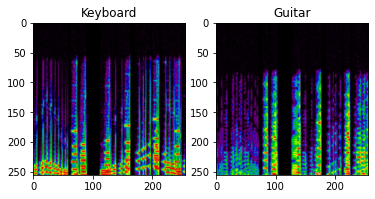

In [ ]:
# Mostramos las imagenes muestra anteriormente definidas.
plt.subplot(121)
plt.title('Keyboard')
plt.imshow(sample_keyboard[0]*0.5 +  0.5)

plt.subplot(122)
plt.title('Guitar')
plt.imshow(sample_guitar[0]*0.5 +  0.5)

## Importamos y reutilizamos los generadores y discriminadores de Pix2Pix


Importamos el generador y discriminador usado en el modelo [Pix2Pix](https://github.com/tensorflow/examples/blob/master/tensorflow_examples/models/pix2pix/pix2pix.py) que viene dentro del paquete de [tensorflow_examples](https://github.com/tensorflow/examples).

Hay 2 generadores (G y F) y 2 discriminadores (X e Y) lo cuales son entrenados.

* El Generador `G` aprende a transformar la imagen `X` en imagen `Y`. $(G: X -> Y)$
* El Generador `F` aprende a transformar la imagen `Y` en imagen `X`. $(F: Y -> X)$
* El Discriminador `D_X` aprende a diferenciar entre la imagen `X` y la imagen generada `X` (`F(Y)`).
* El Discriminador `D_Y` aprende a diferenciar entre la imagen `Y` y la imagen generada `Y` (`G(X)`).

![Cyclegan model](https://www.tensorflow.org/tutorials/generative/images/cyclegan_model.png)

In [ ]:
# Instalamos tensorflow_examples
!pip install -q git+https://github.com/tensorflow/examples.git

In [ ]:
#
from tensorflow_examples.models.pix2pix import pix2pix

### Creamos los generadores y discriminadores para teclado y guitarra

In [ ]:
OUTPUT_CHANNELS = 3

generator_g = pix2pix.unet_generator(OUTPUT_CHANNELS, norm_type='instancenorm')
generator_f = pix2pix.unet_generator(OUTPUT_CHANNELS, norm_type='instancenorm')

discriminator_x = pix2pix.discriminator(norm_type='instancenorm', target=False)
discriminator_y = pix2pix.discriminator(norm_type='instancenorm', target=False)

<Figure size 576x576 with 0 Axes>

Text(0.5, 1.0, 'Keyboard')

Text(0.5, 1.0, 'To Guitar')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Guitar')

Text(0.5, 1.0, 'To Keyboard')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


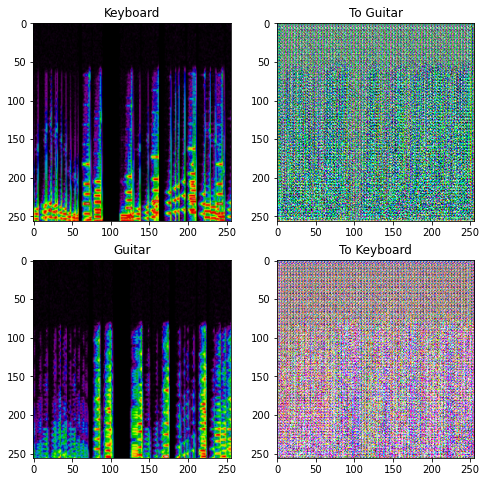

In [ ]:
# Mostramos los resultados de generadores sin entrenar
to_guitar = generator_g(sample_keyboard)
to_keyboard = generator_f(sample_guitar)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_keyboard, to_guitar, sample_guitar, to_keyboard]
title = ['Keyboard', 'To Guitar', 'Guitar', 'To Keyboard']

for i in range(len(imgs)):
  plt.subplot(2, 2, i+1)
  plt.title(title[i])
  if i % 2 == 0:
    plt.imshow(imgs[i][0] * 0.5 + 0.5)
  else:
    plt.imshow(imgs[i][0] * 0.5 * contrast + 0.5)
plt.show()

<Figure size 576x576 with 0 Axes>

Text(0.5, 1.0, 'Is a real Guitar?')

Text(0.5, 1.0, 'Is a real Keyboard?')

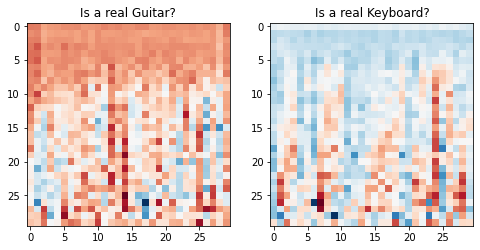

In [ ]:
# Mostramos los resultados de los Discriminadores áun sin entrenar.
plt.figure(figsize=(8, 8))

plt.subplot(121)
plt.title('Is a real Guitar?')
plt.imshow(discriminator_y(sample_guitar)[0, ..., -1], cmap='RdBu_r')

plt.subplot(122)
plt.title('Is a real Keyboard?')
plt.imshow(discriminator_x(sample_keyboard)[0, ..., -1], cmap='RdBu_r')

plt.show()

## Creamos las funciones de pérdida

In [ ]:
# Funciones de pérdida
LAMBDA = 10
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real, generated):
  real_loss = loss_obj(tf.ones_like(real), real)

  generated_loss = loss_obj(tf.zeros_like(generated), generated)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss * 0.5

def generator_loss(generated):
  return loss_obj(tf.ones_like(generated), generated)

def calc_cycle_loss(real_image, cycle_image):
  loss1 = tf.reduce_mean(tf.abs(real_image - cycle_image))
  return LAMBDA * loss1

def identity_loss (real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image))
  return LAMBDA * 0.5 * loss

In [ ]:
# Optimizadores
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

## Entrenamiento del modelo CycleGAN

In [ ]:
# Método auxiliar para mostrar imagenes original y la generada por el modelo.
def generate_images(model, test_input, save=False):
  prediction = model(test_input)
    
  plt.figure(figsize=(12, 12))

  display_list = [test_input[0], prediction[0]]
  title = ['Input_Image', 'Predicted_Image']

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    # Obteniendo los valores de cada pixel en el rango de [0, 1] para plotearlos.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('on')
  plt.show()

  if save:
    for i in range(2):
      plt.title(title[i])
      plt.imshow(display_list[i] * 0.5 + 0.5)
      plt.savefig(title[i]+".png")
      plt.show()

In [ ]:
# Writer for logs
wd = "/content/drive/My Drive/Proyecto Deep Learning - Grupo F/"
os.chdir(wd)

import datetime
log_dir= "logs/"
# log_dir = "/content/drive/My Drive/Proyecto Deep Learning - Grupo F/logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "train/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

@tf.function
def train_step(real_x, real_y, epoch):
  # persistent is set to True because the tape is used more than
  # once to calculate the gradients.
  with tf.GradientTape(persistent=True) as tape:
    # Generator G translates X -> Y
    # Generator F translates Y -> X.
    
    fake_y = generator_g(real_x, training=True)
    cycled_x = generator_f(fake_y, training=True)

    fake_x = generator_f(real_y, training=True)
    cycled_y = generator_g(fake_x, training=True)

    # same_x and same_y are used for identity loss.
    same_x = generator_f(real_x, training=True)
    same_y = generator_g(real_y, training=True)

    disc_real_x = discriminator_x(real_x, training=True)
    disc_real_y = discriminator_y(real_y, training=True)

    disc_fake_x = discriminator_x(fake_x, training=True)
    disc_fake_y = discriminator_y(fake_y, training=True)

    # calculate the loss
    gen_g_loss = generator_loss(disc_fake_y)
    gen_f_loss = generator_loss(disc_fake_x)
    
    total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
    
    # Total generator loss = adversarial loss + cycle loss
    total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
    total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

    disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
    disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
  
  # Calculate the gradients for generator and discriminator
  generator_g_gradients = tape.gradient(total_gen_g_loss, 
                                        generator_g.trainable_variables)
  generator_f_gradients = tape.gradient(total_gen_f_loss, 
                                        generator_f.trainable_variables)
  
  discriminator_x_gradients = tape.gradient(disc_x_loss, 
                                            discriminator_x.trainable_variables)
  discriminator_y_gradients = tape.gradient(disc_y_loss, 
                                            discriminator_y.trainable_variables)
  
  # Apply the gradients to the optimizer
  generator_g_optimizer.apply_gradients(zip(generator_g_gradients, 
                                            generator_g.trainable_variables))

  generator_f_optimizer.apply_gradients(zip(generator_f_gradients, 
                                            generator_f.trainable_variables))
  
  discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients,
                                                discriminator_x.trainable_variables))
  
  discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients,
                                                discriminator_y.trainable_variables))
  
  # Guardamos en el log los valores de las funciones de pérdida en cada época.
  with summary_writer.as_default():
    tf.summary.scalar('gen_g_loss', gen_g_loss, step=epoch)
    tf.summary.scalar('gen_f_loss', gen_f_loss, step=epoch)
    tf.summary.scalar('total_cycle_loss', total_cycle_loss, step=epoch)
    tf.summary.scalar('total_gen_g_loss', total_gen_g_loss, step=epoch)
    tf.summary.scalar('total_gen_f_loss', total_gen_f_loss, step=epoch)
    tf.summary.scalar('disc_x_loss', disc_x_loss, step=epoch)
    tf.summary.scalar('disc_y_loss', disc_y_loss, step=epoch)

### Checkpoints

In [ ]:
# checkpoint_path = "/checkpoints/train"
checkpoint_path = "/content/drive/My Drive/Proyecto Deep Learning - Grupo F/checkpoints/train"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  print ('\nLatest checkpoint restored!!')


Latest checkpoint restored!!


### TensorBoard

In [ ]:
# Cargamos el tablero de tensorflow para visualizar las funciones de pérdida
%load_ext tensorboard
%tensorboard --logdir {log_dir}
#Ejecutar estas lineas antes de realizar el entrenamiento para visualizar el Board
# Entrenamiento realizado:

<IPython.core.display.Javascript object>

### Bucle de Entrenamiento

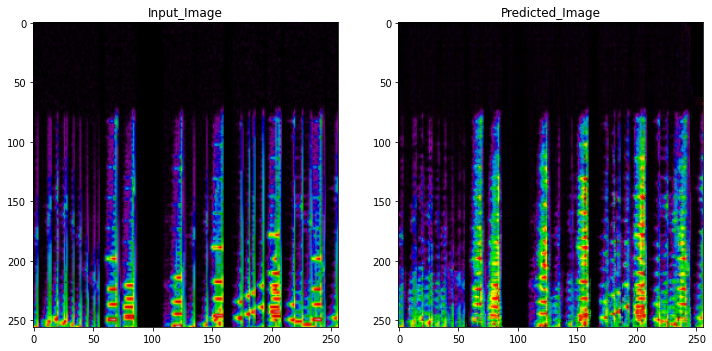

Saving checkpoint for epoch 20 at /content/drive/My Drive/Proyecto Deep Learning - Grupo F/checkpoints/train/ckpt-11
Time taken for epoch 20 is 1213.5423080921173 sec

CPU times: user 3h 44min 6s, sys: 2h 41min 1s, total: 6h 25min 7s
Wall time: 6h 39min 29s


In [ ]:
%%time
#Bucle para el entrenamiento del modelo
EPOCHS = 20

for epoch in range(EPOCHS):
  start = time.time()

  n = 0
  for image_x, image_y in tf.data.Dataset.zip((keyboard_train_dataset, guitar_train_dataset)):
    train_step(image_x, image_y, epoch)
    if n % 10 == 0:
      print ('.', end='')
    n+=1

  clear_output(wait=True)
  # Using a consistent image (sample_keyboard) so that the progress of the model
  # is clearly visible.
  generate_images(generator_g, sample_keyboard)

  if (epoch + 1) % 2 == 0:
    ckpt_save_path = ckpt_manager.save()
    print ('Saving checkpoint for epoch {} at {}'.format(epoch+1,
                                                         ckpt_save_path))

  print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                      time.time()-start))

## Generando imágenes el el test dataset

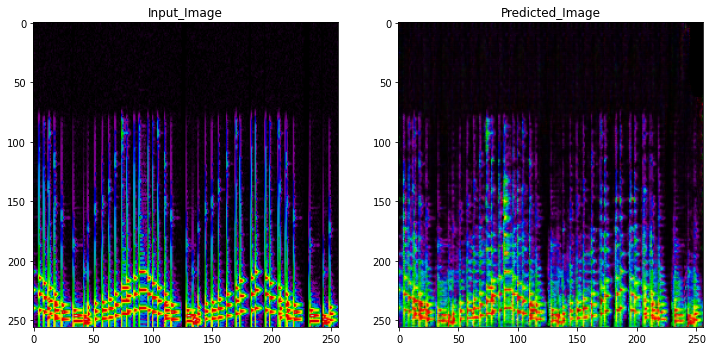

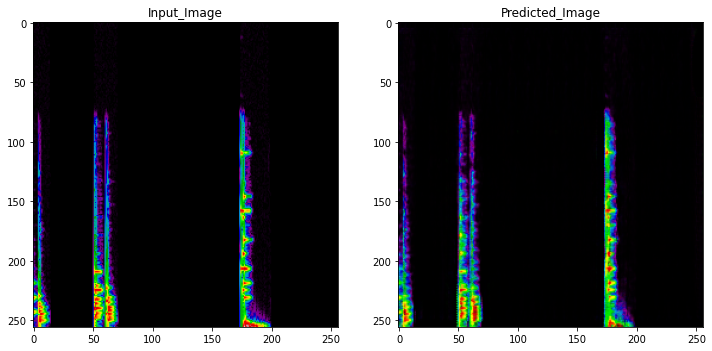

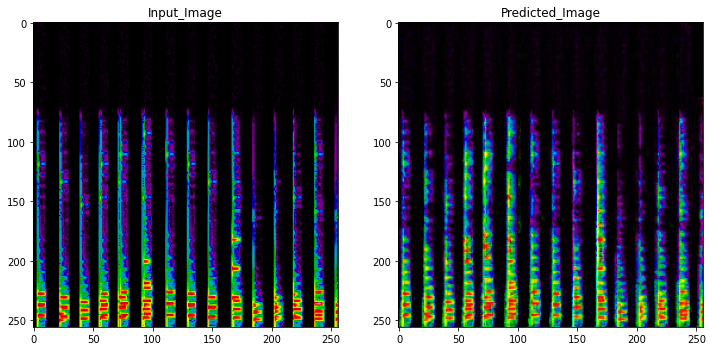

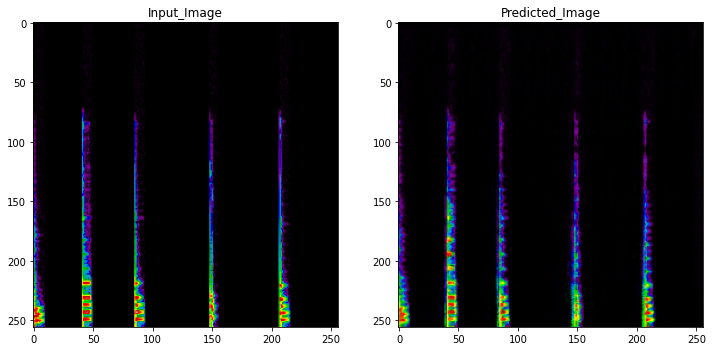

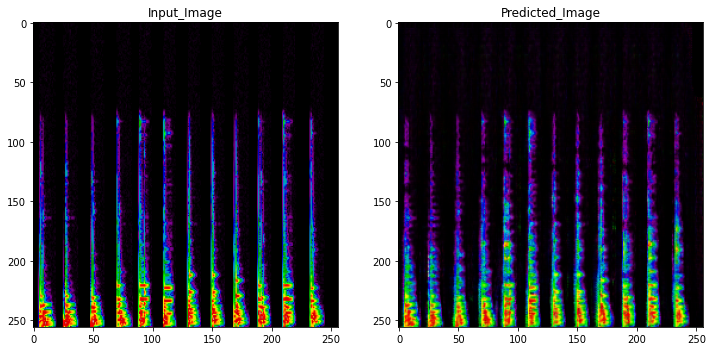

In [ ]:
# Pruebas: 
# Run the trained model on the test dataset
for inp in keyboard_test_dataset.take(5):
  # inp
  generate_images(generator_g, inp, False)

# WavToImg and ImgToWav
Métodos auxiliares para generarar el espectograma (imágenes .png) de un archivo .wav y también para reconstruir un audio en base a sus imagenes .png 

## WavToImg.py

In [ ]:
# Librerías necesarias:
import numpy as np
import scipy.io.wavfile
import sounddevice as sd
import librosa
import matplotlib.image as img
import matplotlib.pyplot as plt
import os

# Remover frecuencia de la magnitud:
def remove_hf(mag):
    return mag[0:int(mag.shape[0]/2), :]

# Cortar en arrays:
def slice_first_dim(array, slice_size):
    n_sections = int(np.floor(array.shape[1]/slice_size))
    has_last_mag = n_sections*slice_size < array.shape[1]

    last_mag = np.zeros(shape=(1, array.shape[0], slice_size, array.shape[2]))
    last_mag[:,:,:array.shape[1]-(n_sections*slice_size),:] = array[:,n_sections*int(slice_size):,:]
    
    if(n_sections > 0):
        array = np.expand_dims(array, axis=0)
        sliced = np.split(array[:,:,0:n_sections*slice_size,:], n_sections, axis=2)
        sliced = np.concatenate(sliced, axis=0)
        if(has_last_mag): # Check for reminder
            sliced = np.concatenate([sliced, last_mag], axis=0)
    else:
        sliced = last_mag
    return sliced

# Adelantar transformación:
def forward_transform(audio, nfft=1024, normalize=True, crop_hf=True):
    window = np.hanning(nfft)
    S = librosa.stft(audio, n_fft=nfft, hop_length=int(nfft/2), window=window)
    mag, phase = np.abs(S), np.angle(S)
    if(crop_hf):
        mag = remove_hf(mag)
    if(normalize):
        mag = 2 * mag / np.sum(window)
    return mag, phase

# Amplitud a decibel
def amplitude_to_db(mag, amin=1/(2**16), normalize=True):
    mag_db = 20*np.log1p(mag/amin)
    if(normalize):
        mag_db /= 20*np.log1p(1/amin)
    return mag_db

# Cortar magnitud
def slice_magnitude(mag, slice_size):
    magnitudes = np.stack([mag], axis=2)
    return slice_first_dim(magnitudes, slice_size)

# Imagen a Wav:
def wavToImg(filename,origin_path,target_path):
    samplerate, data = scipy.io.wavfile.read(origin_path+filename);    
    datnorm = data * (1/abs(data).max())
    mag_input, phase = forward_transform(datnorm)                       # Short Time Fourier Transform
    mag_input = amplitude_to_db(mag_input)                              # convierte a amplitud db
    test_input = slice_magnitude(mag_input, mag_input.shape[0])         # corta en pedazos de 256x256
    test_input = (test_input * 2) - 1                                   # escala de [0,1] a [-1,1]
    base = os.path.splitext(filename)[0]+'_'
    for slice in range(test_input.shape[0]):
        img.imsave(os.path.join(target_path,base+str(slice+1).zfill(3)+'.png'),
                                test_input[slice,:,:,0],
                                cmap='nipy_spectral',
                                origin='lower')
#        plt.imshow(test_input[slice,:,:,0],cmap='nipy_spectral',origin='lower')   # muestra imagen
#        plt.show()
    return data.shape[0],samplerate,phase

# Reproducir canción:
def playWav(filename):
    samplerate, data = scipy.io.wavfile.read(filename);
    sd.play(data, samplerate);
    

## ImgToWav.py

In [ ]:
# Librerías necesarias:
import numpy as np
import matplotlib.image as img
import matplotlib.pyplot as plt
import scipy.io.wavfile
import librosa
import os
import scipy.cluster.vq as scv
import fnmatch

# Carpetas:
def files_within(directory_path, pattern="*"):
    for dirpath, _, filenames in os.walk(directory_path):
        for file_name in fnmatch.filter(filenames, pattern):
            yield os.path.join(dirpath, file_name)

# Añadir frecuencia:            
def add_hf(mag, target_shape):
    rec = np.zeros(target_shape)
    rec[0:mag.shape[0],0:mag.shape[1]] = mag
    return rec

# Invertir transformación:
def inverse_transform(mag, phase, nfft=1024, normalize=True, crop_hf=True):
    window = np.hanning(nfft)
    if(normalize):
        mag = mag * np.sum(np.hanning(nfft)) / 2
    if(crop_hf):
        mag = add_hf(mag, target_shape=(phase.shape[0], mag.shape[1]))
    R = mag * np.exp(1j*phase)
    audio = librosa.istft(R, hop_length=int(nfft/2), window=window)
    return audio

# Convertir decibeles a amplitud:
def db_to_amplitude(mag_db, amin=1/(2**16), normalize=True):
    if(normalize):
        mag_db *= 20*np.log1p(1/amin)
    return amin*np.expm1(mag_db/20)

# Juntar magnitudes: 
def join_magnitude_slices(mag_sliced, target_shape):
    mag = np.zeros((mag_sliced.shape[1], mag_sliced.shape[0]*mag_sliced.shape[2]))
    for i in range(mag_sliced.shape[0]):
        mag[:,(i)*mag_sliced.shape[2]:(i+1)*mag_sliced.shape[2]] = mag_sliced[i,:,:,0]
    mag = mag[0:target_shape[0], 0:target_shape[1]]
    return mag

# Pasar a mapa de color: 
def colormap2arr(arr,cmap):    
    # http://stackoverflow.com/questions/3720840/how-to-reverse-color-map-image-to-scalar-values/3722674#3722674
    gradient=cmap(np.linspace(0.0,1.0,100))

    # Reshape arr to something like (240*240, 4), all the 4-tuples in a long list...
    arr2=arr.reshape((arr.shape[0]*arr.shape[1],arr.shape[2]))

    # Use vector quantization to shift the values in arr2 to the nearest point in
    # the code book (gradient).
    code,dist=scv.vq(arr2,gradient)

    # code is an array of length arr2 (240*240), holding the code book index for
    # each observation. (arr2 are the "observations".)
    # Scale the values so they are from 0 to 1.
    values=code.astype('float')/gradient.shape[0]

    # Reshape values back to (240,240)
    values=values.reshape(arr.shape[0],arr.shape[1])
    values=values[::-1]
    return values

# Convertir imagen a Wav:
def imgToWav(filename,origin_path,target_path,wav_len,rate,phase):
    base = os.path.splitext(filename)[0]
    wavfiles = list(files_within(origin_path,base+'_*.png'))
    wavfiles.sort()
    mag_input=np.zeros([256,0])
    for wavv in wavfiles:
        imgw=img.imread(wavv)
        data=colormap2arr(imgw, plt.cm.nipy_spectral)
#        plt.imshow(data,cmap='nipy_spectral',origin='lower')
#        plt.show()
        mag_input=np.hstack((mag_input,data))
#    plt.imshow(data_tot,cmap='nipy_spectral',origin='lower')
#    plt.show()
    mag_input=db_to_amplitude(mag_input)
    audio=inverse_transform(mag_input[:,:phase.shape[1]], phase)
    audio=audio[:wav_len]
    scipy.io.wavfile.write(os.path.join(target_path,filename), rate, audio)


# Procesar cancion

In [ ]:
# Descompresión de audios:
# !unrar x "/content/drive/My Drive/Proyecto Deep Learning - Grupo F/Data/keyboard_electronic_song.rar"


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/drive/My Drive/Proyecto Deep Learning - Grupo F/Data/keyboard_electronic_song.rar

Extracting  MIDI-Unprocessed_01_R1_2006_01-09_ORIG_MID--AUDIO_01_R1_2006_01_Track01_wav.wav       4%  8% 12% 16% 20% 25% 29% 32%  OK 
Extracting  MIDI-Unprocessed_01_R1_2006_01-09_ORIG_MID--AUDIO_01_R1_2006_02_Track02_wav.wav      36% 40% 44%  OK 
Extracting  MIDI-Unprocessed_01_R1_2006_01-09_ORIG_MID--AUDIO_01_R1_2006_03_Track03_wav.wav      48% 52% 56% 60%  OK 
Extracting  MIDI-Unprocessed_01_R1_2006_01-09_ORIG_MID--AUDIO_01_R1_2006_04_Track04_wav.wav      64% 69%  OK 
Extracting  MIDI-Unprocessed_01_R1_2006_01-09_ORIG_MID--AUDIO_01_R1_2006_05_Track05_wav.wav      73% 77% 78%  OK 
Extracting  MIDI-Unprocessed_01_R1_2008_01-04_ORIG_MID--AUDIO_01_R1_2008_wav--1.wav      83% 84%  OK 
Extracting  M

In [ ]:
# Set de directorio:
wd = "/content/"
os.chdir(wd)
!ls

drive  sample_data


In [ ]:
# Limpiamos el directorio de salida 
for f in os.listdir("/content/songoutput/"):
  os.remove("/content/songoutput/"+f)
os.listdir("/content/songoutput/")

[]

## Convertimos WAV a IMG

In [ ]:
# Librerías para la conversión del archivo WAV a IMG:
%%time
import numpy as np
import scipy.io.wavfile
import sounddevice as sd
import librosa
import matplotlib.image as img
import matplotlib.pyplot as plt
import os

# Rutas:
# wav_path='/content/drive/My Drive/Proyecto Deep Learning - Grupo F/Data/'
wav_path = '/content/'
img_path='/content/songoutput/'
wav_gen_path='/content/guitar_acoustic/'
# file='MIDI-Unprocessed_01_R1_2006_01-09_ORIG_MID--AUDIO_01_R1_2006_01_Track01_wav.wav'
file = 'romantic2_k.wav'

# Conversión del archivo WAV a IMG:
wav_len,samplerate,phase = wavToImg(file,wav_path,img_path) 


CPU times: user 4.09 s, sys: 80.4 ms, total: 4.17 s
Wall time: 4.18 s


## Cargamos las imágenes
Las imagenes de los espectogramas generados son cargadas como tensores para luego ser transformadas usando el modelo cyclegan generado.

In [ ]:
# Carga de imágenes: 
song_dataset = os.listdir(img_path)
song_dataset = tf.data.Dataset.from_tensor_slices(song_dataset)
song_dataset = song_dataset.map(lambda x: load_train_image(img_path + x), num_parallel_calls = tf.data.experimental.AUTOTUNE)
song_dataset = song_dataset.batch(1)


In [ ]:
# Limpiamos directorio
for f in os.listdir("/content/guitar_acoustic/"):
  os.remove("/content/guitar_acoustic/"+f)
os.listdir("/content/guitar_acoustic/")

[]

## Trasformación de imágenes con CycleGAN generado

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

<Figure size 1080x1080 with 0 Axes>

(-0.5, 255.5, 255.5, -0.5)

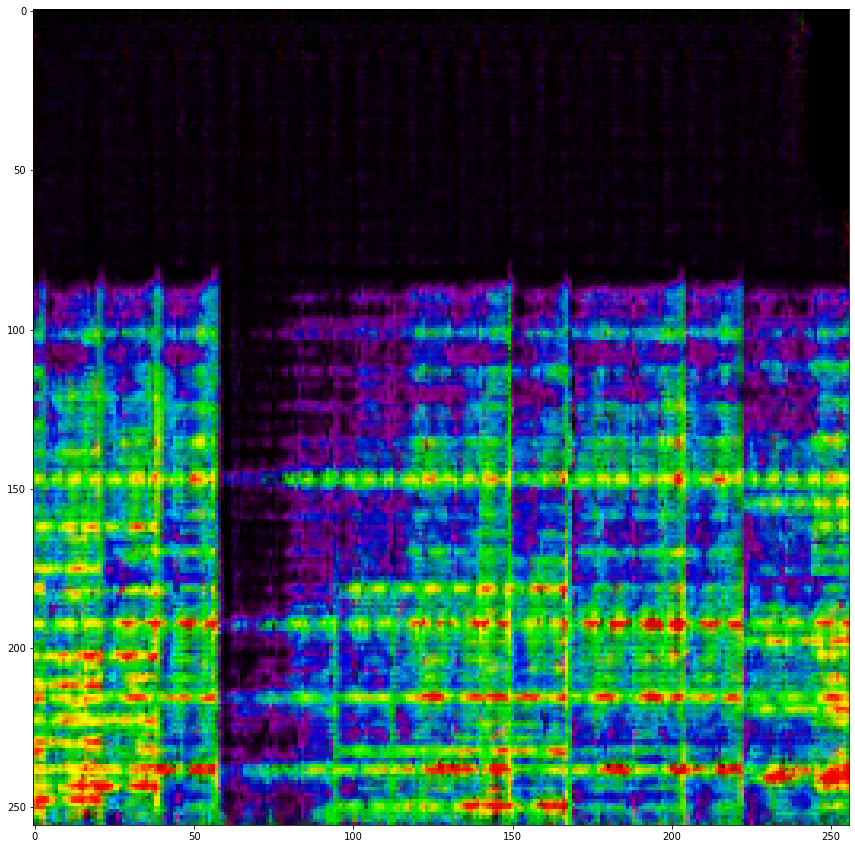

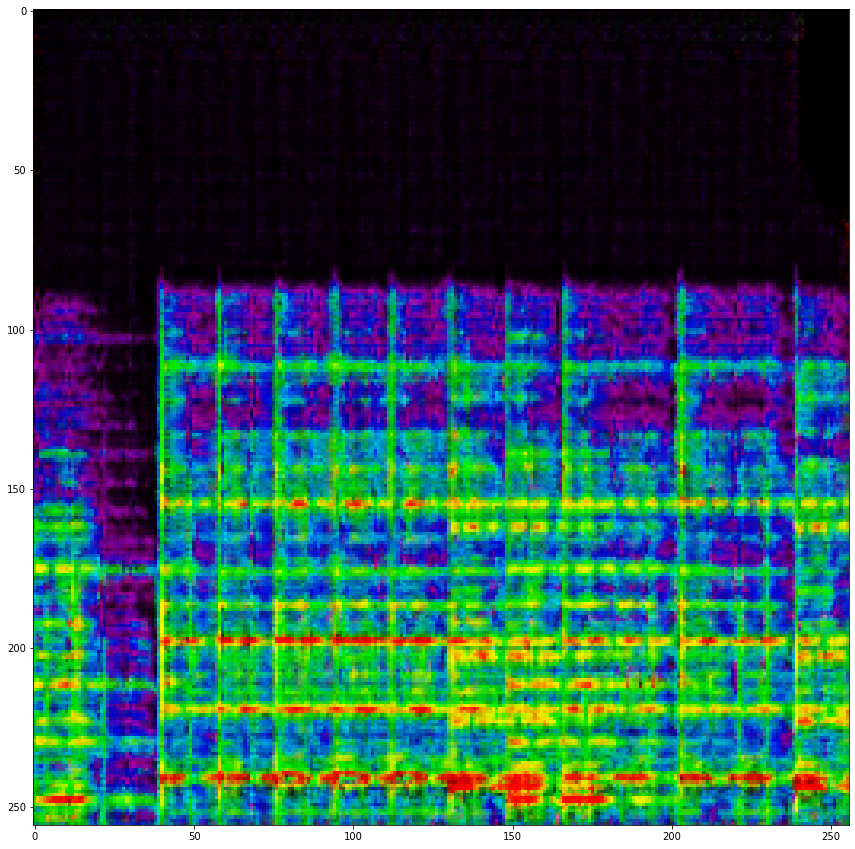

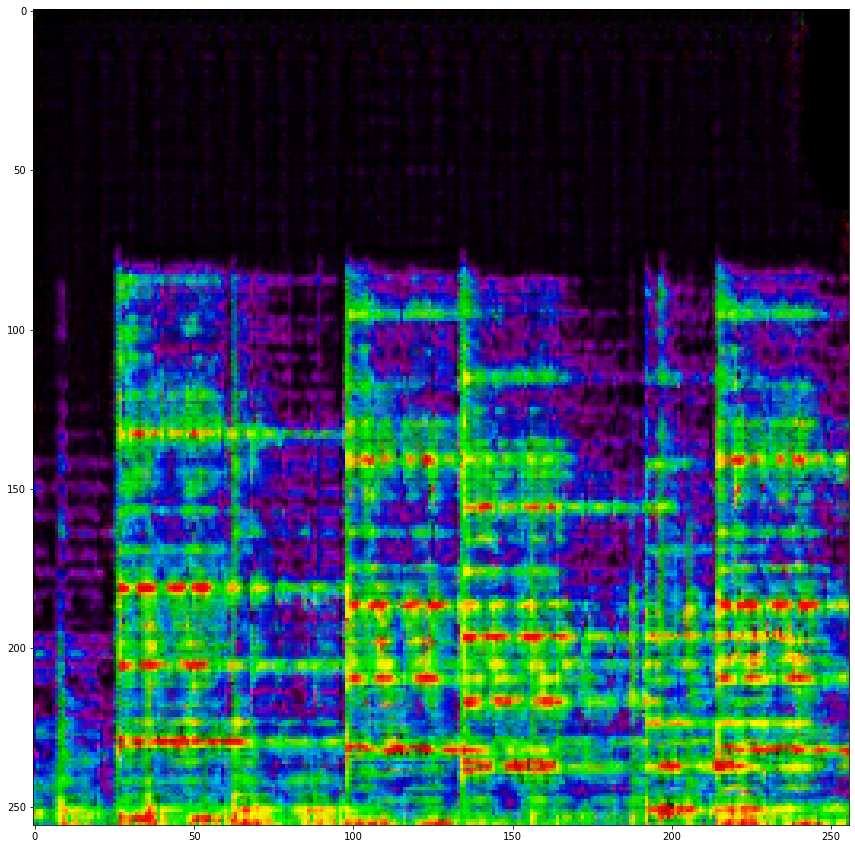

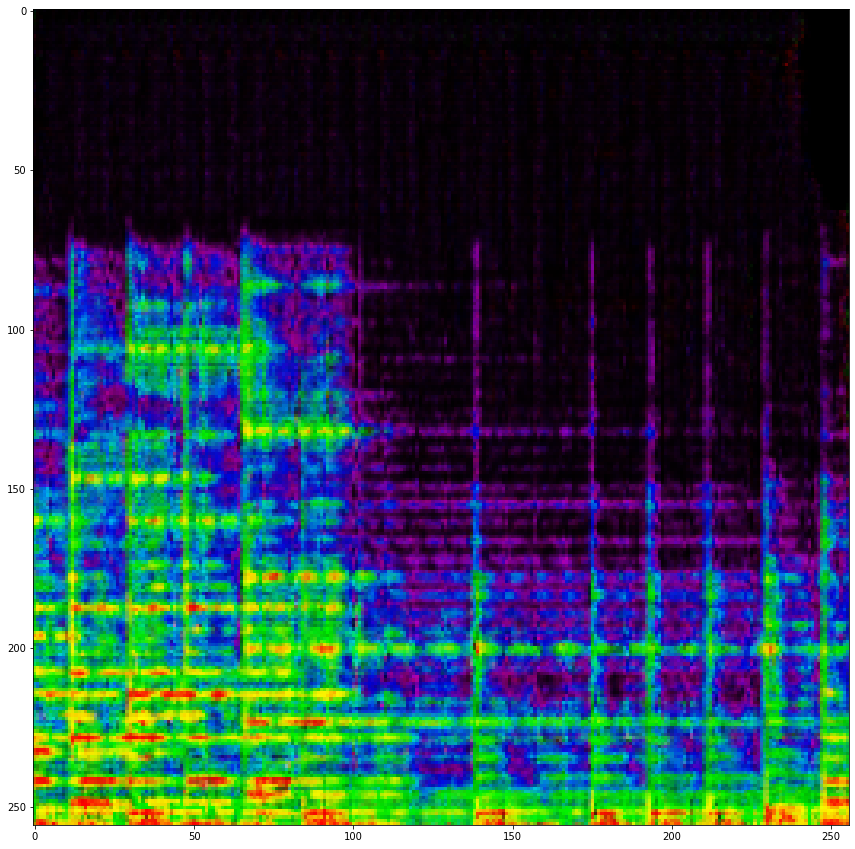

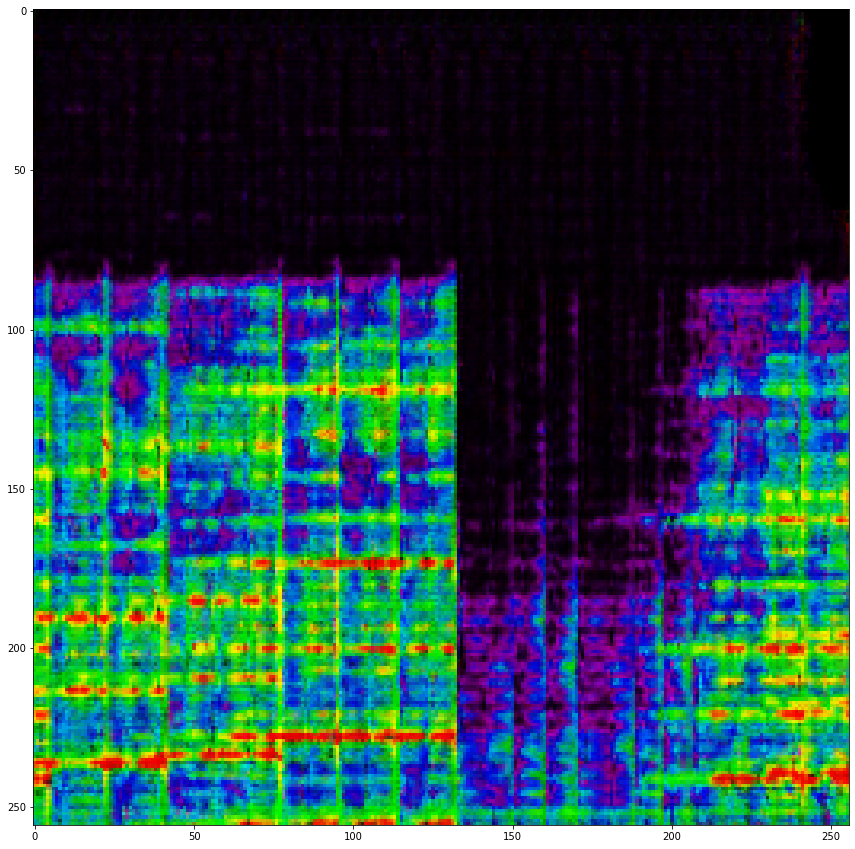

...

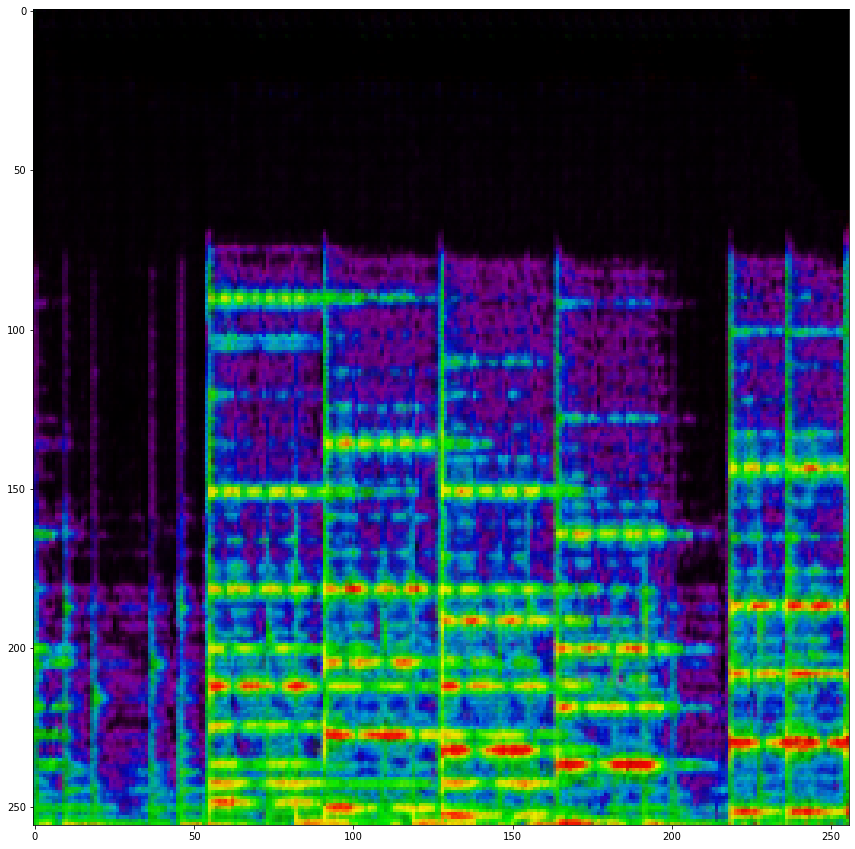

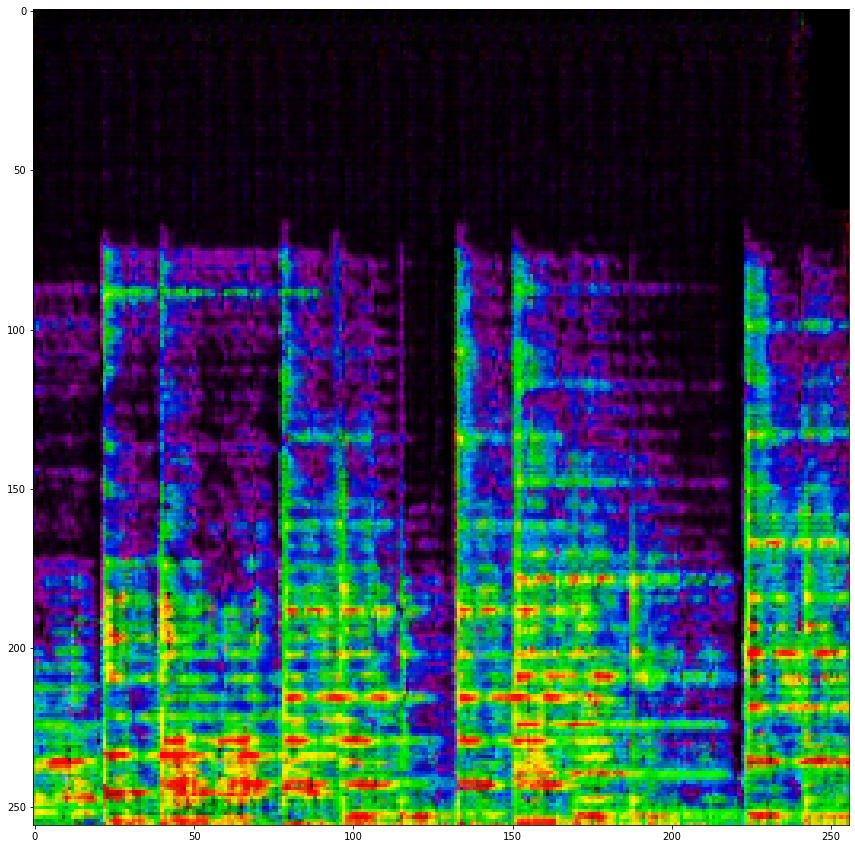

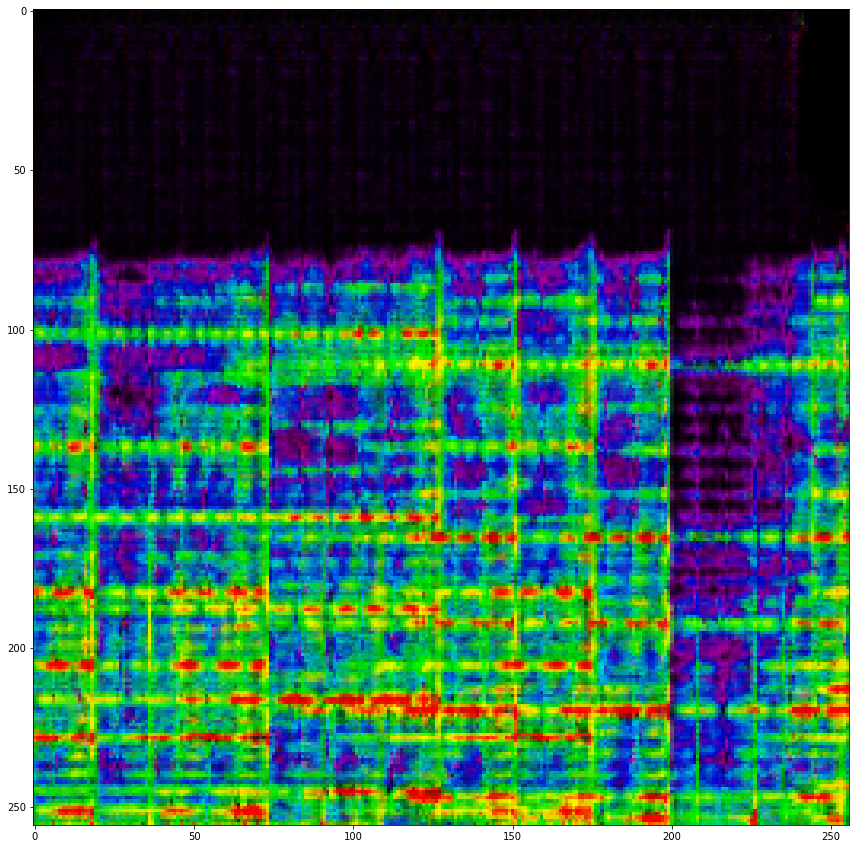

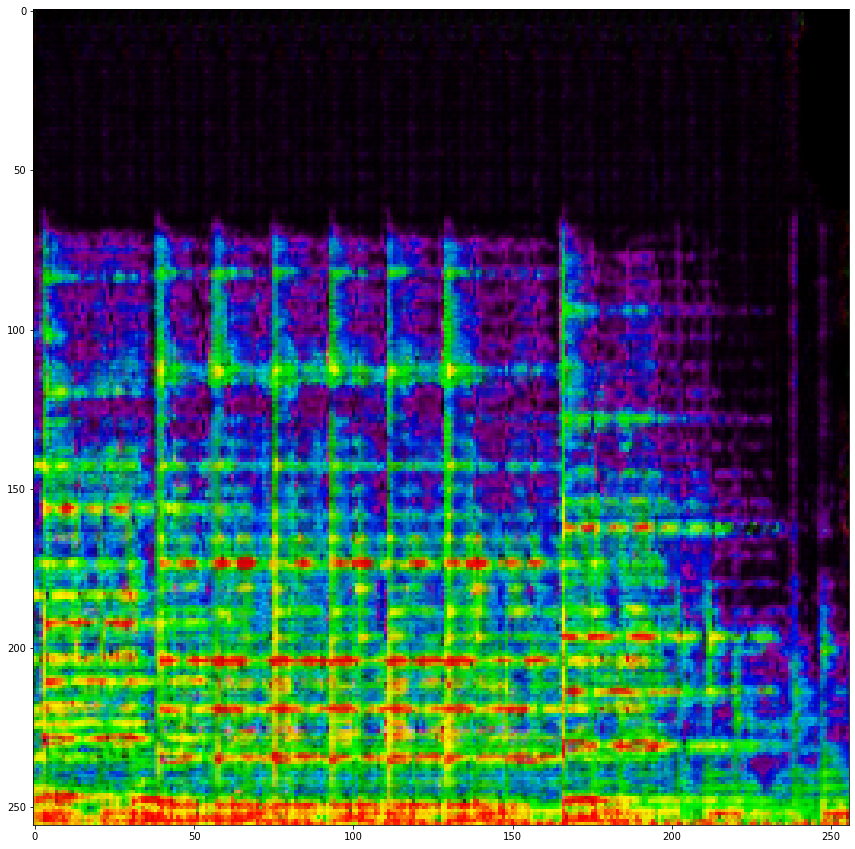

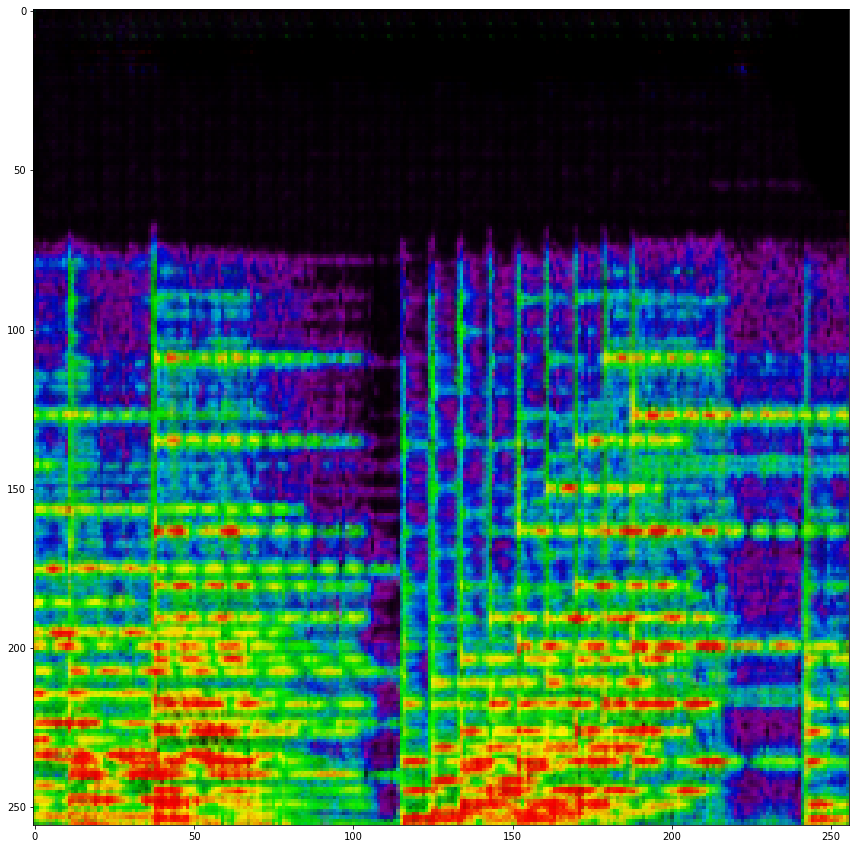

In [ ]:
# Transformación de imagen de salida:
i = 1
size = len(os.listdir("/content/songoutput/"))
for img in song_dataset.take(size):
  prediction = generator_g(img)

  plt.figure()
  plt.imshow(prediction[0]*0.5+0.5)
  plt.axis('on')
  plt.savefig(wav_gen_path + "Output_{}.png".format(i))
  # plt.show()
  i = i + 1


## Reconstrucción de archivo WAV

In [ ]:
# # Librerías requeridas para reconstruir el archivo wav:
import numpy as np
import matplotlib.image as img
import matplotlib.pyplot as plt
import scipy.io.wavfile
import librosa
import os
import scipy.cluster.vq as scv
import fnmatch

# Conversión de Img a Wav:
imgToWav(file, img_path, wav_gen_path, wav_len, samplerate, phase)


In [ ]:
# Instalación de la librería requerida para reconstruir el archivo wav:
# !apt-get install libportaudio2

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-440
Use 'apt autoremove' to remove it.
The following NEW packages will be installed:
  libportaudio2
0 upgraded, 1 newly installed, 0 to remove and 35 not upgraded.
Need to get 64.6 kB of archives.
After this operation, 215 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libportaudio2 amd64 19.6.0-1 [64.6 kB]
Fetched 64.6 kB in 0s (1,071 kB/s)
Selecting previously unselected package libportaudio2:amd64.
(Reading database ... 144465 files and directories currently installed.)
Preparing to unpack .../libportaudio2_19.6.0-1_amd64.deb ...
Unpacking libportaudio2:amd64 (19.6.0-1) ...
Setting up libportaudio2:amd64 (19.6.0-1) ...
Processing triggers for libc-bin (2.27-3ubuntu1) ...
/sbin/ldconfig.real: /usr/local/lib/python3.6/dist-packages/ideep4py

# GPU

In [ ]:
# Información de la GPU:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Wed Jul 15 23:00:25 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.51.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   55C    P0    56W / 149W |  10868MiB / 11441MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------